In [1]:
# Import dependencies
%matplotlib inline
import os
import numpy as np
import pandas as pd
import scanpy as sc
import scanpy.external as sce
import seaborn as sns
import anndata
import scvi
import matplotlib.pyplot as plt
import datetime

# Print date and time:
print(f"Current date and time = {datetime.datetime.now()}")

# Set the folder the data will be loaded from (read only)
data_dir = "/project/shared/python/3_python_single_cell/results"
print(f'Data directory: {data_dir}')

# Set a working directory in your own project space where you can write output files
wdir = "/project/olin0164/3_python_single-cell/"
os.chdir(wdir)
print(f'Working directory: {wdir}')

# Create output folders in working directory
RESULTS_FOLDERNAME = "6_annotation/results/"
FIGURES_FOLDERNAME = "6_annotation/figures/"
os.makedirs(RESULTS_FOLDERNAME, exist_ok=True)
os.makedirs(FIGURES_FOLDERNAME, exist_ok=True)
    
# Set folder for saving figures into and figure saving parameters
sc.settings.figdir = FIGURES_FOLDERNAME
sc.set_figure_params(dpi=150, fontsize=10, dpi_save=600)

# Set other settings
sc.settings.verbosity = 3 # verbosity: errors (0), warnings (1), info (2), hints (3)
sc._settings.ScanpyConfig.max_memory = 100 # maximum memory given to scanpy (in GB)
sc._settings.ScanpyConfig.n_jobs = 8 # maximum number of threads given to scanpy

# print out the package versions - good for troubleshooting and reproducibility
sc.logging.print_versions()

Current date and time = 2025-02-12 14:48:44.165398
Data directory: /project/shared/python/3_python_single_cell/results
Working directory: /project/olin0164/3_python_single-cell/
-----
anndata     0.11.3
scanpy      1.10.4
-----
CyOpenGL                    NA
Cython                      3.0.11
FXrays                      1.3.6
PIL                         11.1.0
SnapPy                      NA
SnapPyHP                    NA
absl                        NA
anyio                       NA
arrow                       1.3.0
asttokens                   NA
attr                        25.1.0
attrs                       25.1.0
babel                       2.13.1
backports                   NA
brotli                      1.1.0
certifi                     2025.01.31
charset_normalizer          3.4.1
chex                        0.1.88
cloudpickle                 3.1.1
colorama                    0.4.6
comm                        0.2.2
cycler                      0.12.1
cypari                      2.5.5

/package/python-cbrg/current/3.11/lib/python3.11/site-packages/session_info/main.py:213: UserWarning: The '__version__' attribute is deprecated and will be removed in MarkupSafe 3.1. Use feature detection, or `importlib.metadata.version("markupsafe")`, instead.
  mod_version = _find_version(mod.__version__)


In [2]:
adata = sc.read_h5ad(os.path.join(data_dir, 'dev_scVI.h5ad'))
adata

AnnData object with n_obs × n_vars = 23281 × 2374
    obs: 'samplename', 'sex', 'age', 'donor', 'type', 'libbatch', 'barcode', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'mt_outlier', 'doublet_score', 'predicted_doublet', 'size_factors', 'S_score', 'G2M_score', 'phase', '_scvi_batch', '_scvi_labels'
    var: 'n_counts', 'means', 'variances', 'residual_variances', 'highly_variable_rank', 'highly_variable_nbatches', 'highly_variable_intersection', 'highly_variable', 'mean', 'std'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'donor_colors', 'hvg', 'libbatch_colors', 'log1p', 'neighbors', 'pca', 'phase_colors', 'samplename_colors', 'sex_colors', 'type_colors', 'umap'
    obsm: 'X_

In [3]:
adata.var_names_make_unique()

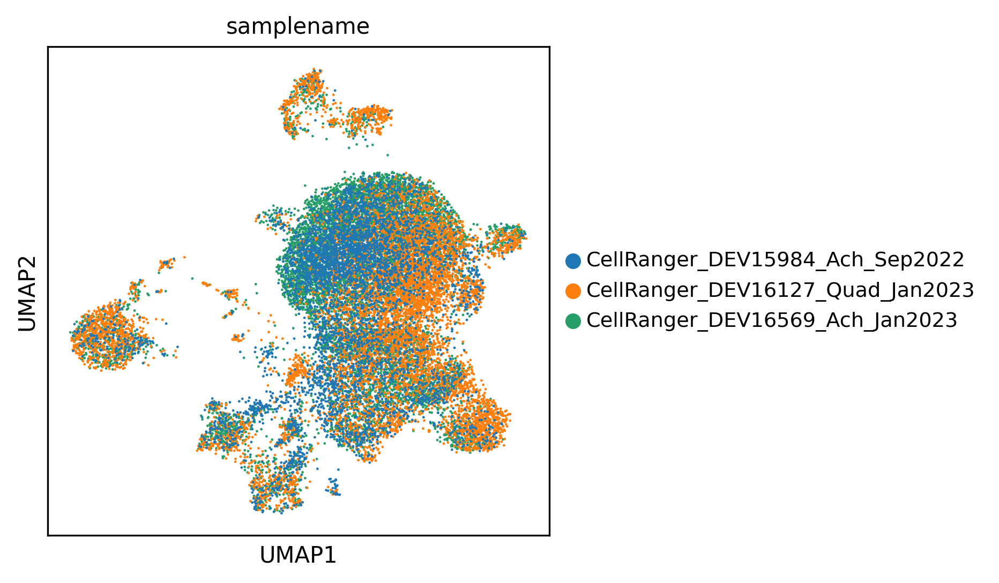

In [4]:
sc.pl.umap(adata, color='samplename')

### Check the shape of adata.X, adata.raw.X, and the different layers. Why are the shapes different?

In [5]:
print(adata.X.shape)
print(adata.raw.X.shape)
print(adata.layers['counts'].shape)
print(adata.layers['regressed'].shape)
print(adata.layers['scranPY'].shape)

(23281, 2374)
(23281, 21298)
(23281, 2374)
(23281, 2374)
(23281, 2374)


The X and layers matrices only contain the variable genes, while the raw matrix contains all genes.

### Check if adata.raw.X contains raw or normalised genes

In [6]:
print(adata.raw.X[0:5,0:5])

<Compressed Sparse Row sparse matrix of dtype 'float64'
	with 3 stored elements and shape (5, 5)>
  Coords	Values
  (0, 3)	0.25244685837042874
  (3, 1)	0.2432911887437752
  (4, 3)	0.2561850535891846


These are the scranPY-normalised counts.

### Which counts (all vs HVG / normalised or not) should we use for differential gene expression testing for annotation purposes?

Debatable. But in general, DGE should be run on all genes, either raw and unnormalised or on normalised counts as long as those do not overcorrect the data.

# PART1: We have some idea of what to expect in the data, so let's check the gene lists! (We do this together)

We are looking at samples of developing human tendons. In those samples, we expect to see a variety of different cell types, including fibroblasts and the cells typically associated with the vascular, nervous and lymphatic systems (e.g. immune cells, endothelial cells etc). Some samples may also contain adjacent tissue (muscle and cartilage) cells. Based on this, we expect to see at least about 7 different groups of cells.

### To start, let's focus on macrophages that are likely to be present in this data. Here is a list of macrophage markers:

In [7]:
macrophage_markers = ["F13A1", "CD163", "MRC1", "CSF1R", "CD36", "LGMN"]

### 1) Visualise marker distribution on UMAPs. Are they localised to a single group of cells or distributed throughout the data?

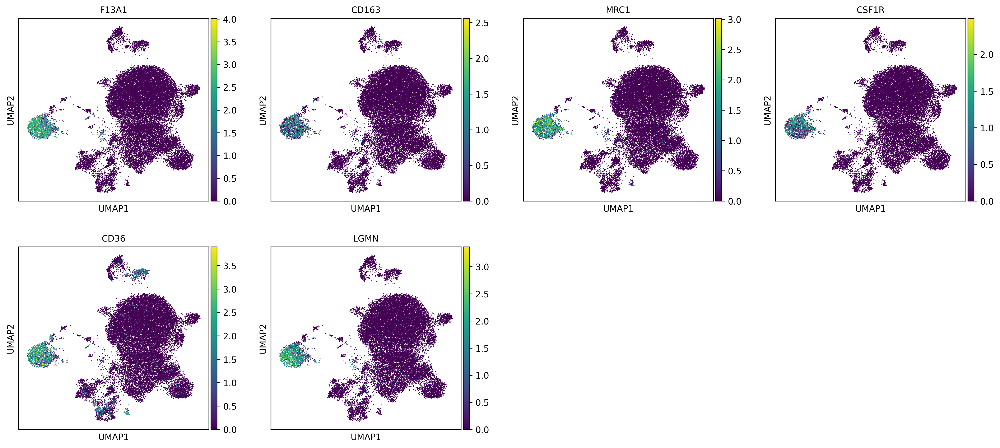

In [8]:
sc.pl.umap(adata, color=macrophage_markers)

### 2) Score these genes using Scanpy's sc.tl.score_genes(). Plot the resulting scores using a UMAP.

In [9]:
sc.tl.score_genes(adata, gene_list=macrophage_markers, score_name='macrophage_score')

computing score 'macrophage_score'
    finished: added
    'macrophage_score', score of gene set (adata.obs).
    250 total control genes are used. (0:00:00)


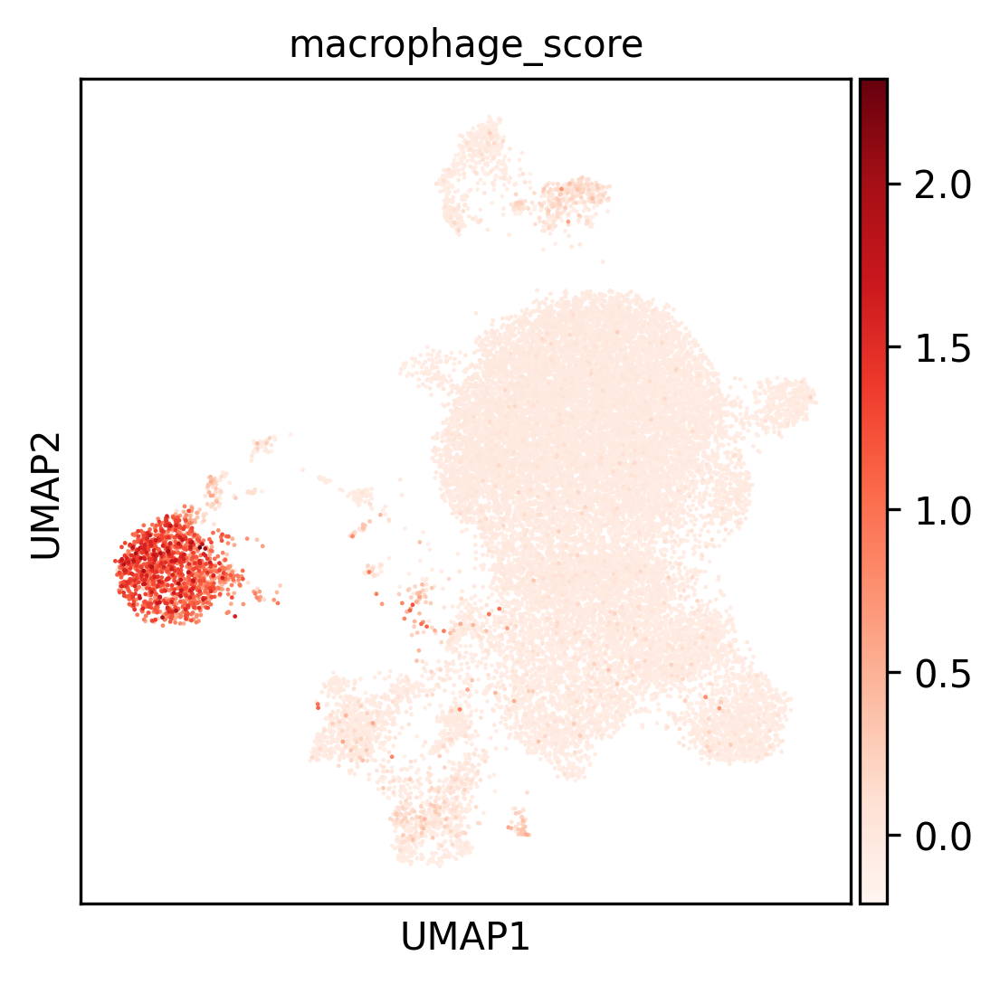

In [10]:
# use cmap='Reds' or any other single colour to better visualise which cells are positive for the macrophage markers.
sc.pl.umap(adata, color='macrophage_score', cmap='Reds')

### Run the following code to calculate the 95th percentile of the macrophage_score column in adata.obs.

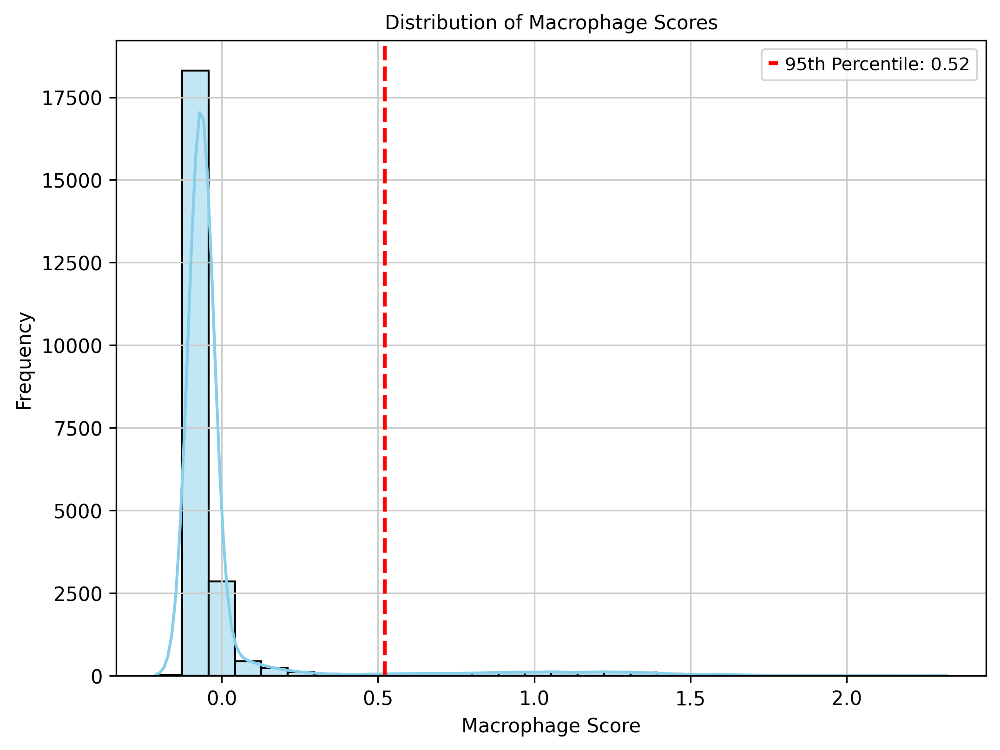

In [11]:
# Extract macrophage scores:
scores = adata.obs['macrophage_score']

# Compute the 95th percentile threshold:
threshold = np.percentile(scores, 95)

# Create the histogram:
plt.figure(figsize=(8, 6))
sns.histplot(scores, bins=30, kde=True, color='skyblue', edgecolor='black')

# Add a vertical line at the 95th percentile:
plt.axvline(threshold, color='red', linestyle='dashed', linewidth=2, label=f'95th Percentile: {threshold:.2f}')

# Labels and title:
plt.xlabel("Macrophage Score")
plt.ylabel("Frequency")
plt.title("Distribution of Macrophage Scores")
plt.legend()

# Show the plot:
plt.show()

### Now, we can make a new column in adata.obs which will set cells to True if the score is above the 95th percentile threshold, or False if it is below. Plot this column in a UMAP:

In [12]:
adata.obs['macrophage_score_95th_percentile'] = (scores > threshold)

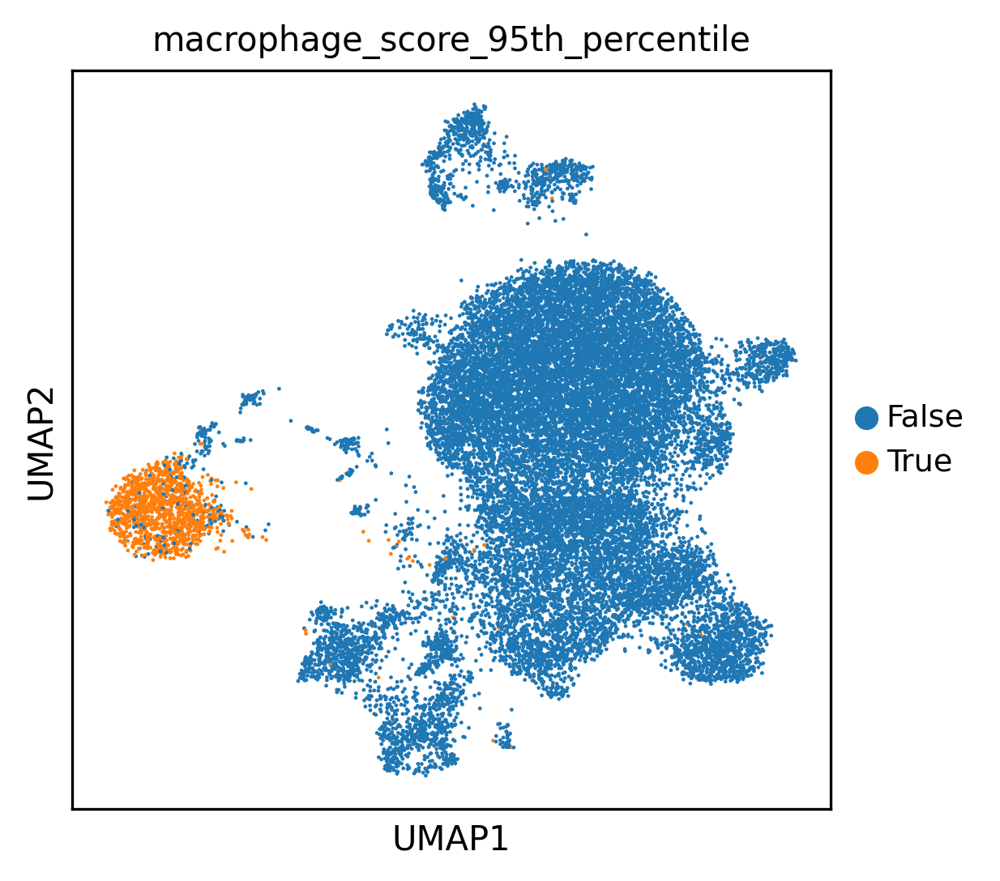

In [13]:
sc.pl.umap(adata, color='macrophage_score_95th_percentile', cmap='Reds')

### 3) Example of how gene scoring can be used to infer cell types and their distributions prior to clustering:

In [14]:
coarse_markers = {
    #muscle cells:
    "Satellite_cells": ["PAX7", "MYF5", "DLK1", "CD34", "VCAM1", "MYOD1", "MYOG"],
    "Skeletal_myocytes": ["MYH7", "TNNT1", "TNNT3", "MYH1", "MYH2", "CKM", "MB", "DES", "TTN", "DMD", 
                  "TNNC1", "TNNI1", "ATP2A2", "TNNC2", "TNNI2", "ATP2A1", "ANKRD2", "NDUFA8", 
                  "MYOM3", "CASQ2", "HSPB6", "RDH11", "AIMP1", "MYLK2", "ACTN3", "MYBPC2", 
                  "PCYOX1", "CAPZA1", "CD38", "PDLIM7", "COBL", "TMEM159", "HNRNPA1", "TFRC"],

    #mural cells:
    "Pericytes": ["RGS5", "ABCC9", "CD146", "NG2", "NOTCH3"],
    "Smooth_myocytes": ["MYH11", "ACTA2", "CNN1", "TAGLN"],
    "Endothelial_general": ["PECAM1", "CDH5", "VEGFA", "ICAM1", "VWF"],
    "Endothelial_lymphatic": ["PROX1", "FLT4", "LYVE1"],

    #fibroblasts:
    "Fibroblasts_1": ["ABI3BP", "GAS2", "KERA", "TNMD", "COL1A1", "MKX", "FMOD", "COL11A1", "SOX5", "EXT1", "SPARC", "POSTN", "COL12A1"],
    "Fibroblasts_2": ["COL3A1", "COL6A6", "LUM", "PI16", "FNDC1", "PDGFRA", "DCLK1", "TSHZ2", "PLAGL1", "VCAN", "SFRP2"],
    "Fibroblasts_3": ["FGF14", "FSTL5", "COL22A1", "SLIT3", "TSHZ2", "CDH12", "BMP5", "EGFR", "THBS4"],
    "Fibroblasts_4": ["NEGR1", "SCN7A", "EBF2", "NAV3", "NRK", "KCNMB2"],
    "Fibroblasts_5": ["PRG4", "CREB5", "TIMP3", "TNXB", "NOVA1"],

    #immune cells:
    "Immune_cells": ["F13A1", "CD163", "MRC1", "CSF1R", "CD36", "LGMN",
                     "FCN1", "LYZ", "IRAK3", "SKAP1", "CD247", "CD96", "CD38", "PRKCH", "BACH2", "EBF1"],
    
    #additional possibilities:
    "Glial_cells": ["NRXN1", "NCAM2", "SOX10", "NCAM1", "CDH19", "PLP1", "S100B", "GFAP"],
    "Adipocytes": ["PLIN1", "ADIPOQ", "MMRN1", "CCL21", "GPAM", "PDE3B"],
    "RBCs": ["HBA1", "HBG"]
}

# Filter markers to make sure you're using genes that are definitely found in your adata.var_names:
filtered_coarse_markers = {}
for key, marker_list in coarse_markers.items():
    filtered_coarse_markers[key] = [marker for marker in marker_list if marker in adata.var_names]

Note that the code below is not a perfect solution in terms of resolving cases where you have more than one highly-scoring cell type! It's just something quick that I thought of for the purposes of having a look prior to clustering and detailed annotation.

In [15]:
def score_and_assign_celltypes(adata, celltype_dict, key_added='coarse_definitive', key_added_probable='coarse_probable'):
    """
    Score genes for cell types.
    
    Parameters:
    adata (AnnData): The AnnData object containing the single-cell data.
    celltype_dict (dict): Dictionary with broad cell types and their gene markers.
    key_added (str): Name of assigned definitive cell type adata.obs column to add
    key_added_probable (str): Name of assigned most probable cell type adata.obs column to add
    
    Returns:
    None: The function updates adata with broad cell type assignments while preserving scores.
    """
    broad_celltypes = list(celltype_dict.keys())
    
    for cell_type, genes in celltype_dict.items():
        try:
            valid_genes = [gene for gene in genes if gene in adata.var_names]
            if not valid_genes:
                raise ValueError(f"No valid genes found for {cell_type}. Skipping.")
            
            sc.tl.score_genes(adata, gene_list=valid_genes, score_name=cell_type)
            scores = adata.obs[cell_type]
            threshold = np.percentile(scores, 95)
            adata.obs[f'{cell_type}_identified'] = (scores > threshold)
        
        except ValueError as e:
            print(f"Warning: {e}")
    
    # Handle conflicts and make final assignments
    adata.obs["conflict"] = adata.obs[broad_celltypes].sum(axis=1) > 1
    adata.obs[key_added] = "none"
    adata.obs.loc[adata.obs["conflict"] == False, key_added] = adata.obs.loc[adata.obs["conflict"] == False, broad_celltypes].idxmax(axis=1)

    # Reassign "none" cells based on the highest scores for top 3 most likely cell types
    adata.obs[key_added_probable] = adata.obs[key_added].copy()
    none_cells = adata.obs[adata.obs[key_added] == "none"]
    none_scores = adata.obs.loc[none_cells.index, broad_celltypes]
    
    # Get top 3 cell types based on scores for "none" cells
    top_celltypes = none_scores.apply(lambda x: x.nlargest(3).index.tolist(), axis=1)
    top_celltypes_df = pd.DataFrame(top_celltypes.tolist(), index=none_cells.index, columns=["Top 1", "Top 2", "Top 3"])
    for idx, row in top_celltypes_df.iterrows():
        adata.obs.loc[idx, key_added_probable] = row["Top 1"]
    
    print("Cell type assignments complete.")
    print(adata.obs[[key_added, key_added_probable]].head())

In [16]:
score_and_assign_celltypes(adata, filtered_coarse_markers, key_added='coarse_definitive', key_added_probable='coarse_probable')

computing score 'Satellite_cells'
    finished: added
    'Satellite_cells', score of gene set (adata.obs).
    99 total control genes are used. (0:00:00)
computing score 'Skeletal_myocytes'
    finished: added
    'Skeletal_myocytes', score of gene set (adata.obs).
    349 total control genes are used. (0:00:00)
computing score 'Pericytes'
    finished: added
    'Pericytes', score of gene set (adata.obs).
    150 total control genes are used. (0:00:00)
computing score 'Smooth_myocytes'
    finished: added
    'Smooth_myocytes', score of gene set (adata.obs).
    150 total control genes are used. (0:00:00)
computing score 'Endothelial_general'
    finished: added
    'Endothelial_general', score of gene set (adata.obs).
    99 total control genes are used. (0:00:00)
computing score 'Endothelial_lymphatic'
    finished: added
    'Endothelial_lymphatic', score of gene set (adata.obs).
    99 total control genes are used. (0:00:00)
computing score 'Fibroblasts_1'
    finished: added
   

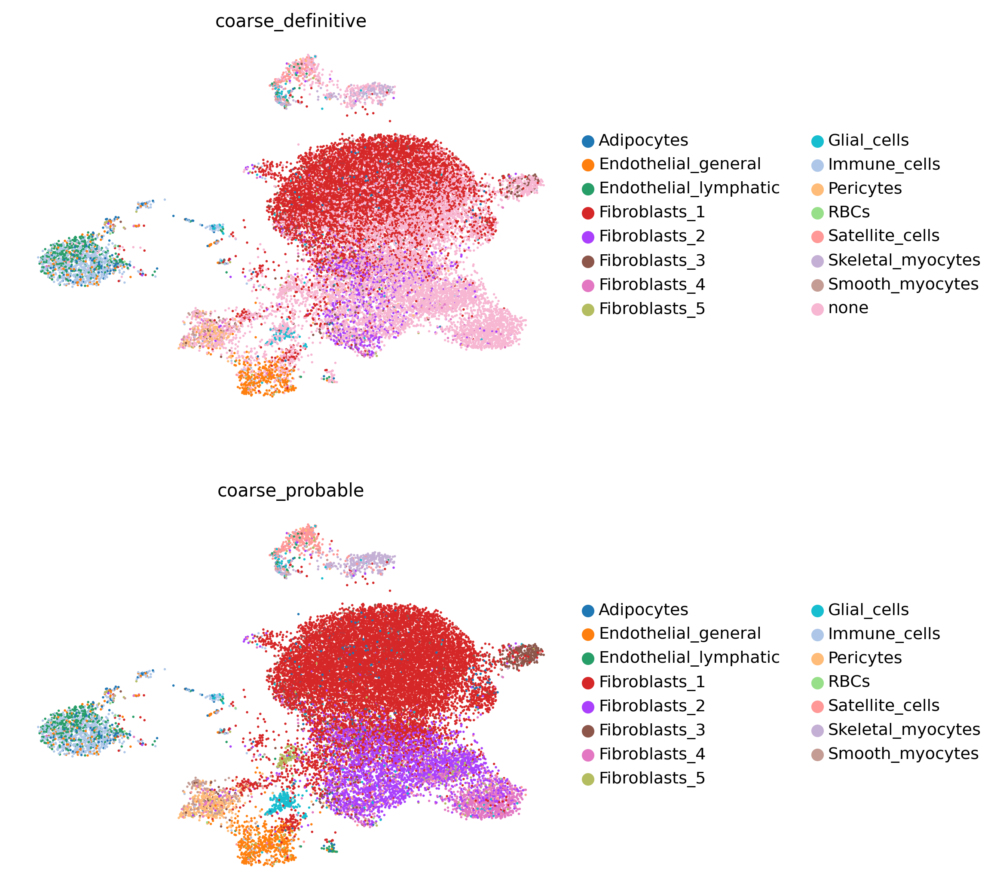

In [17]:
sc.pl.umap(adata,color=["coarse_definitive", "coarse_probable"], 
           ncols=1, wspace=0.5, s=7, frameon=False, #legend_loc='on data',
           save='_coarse_marker_annotations.png')

In [18]:
adata.obs[["coarse_definitive"]].value_counts()

coarse_definitive    
none                     9642
Fibroblasts_1            9042
Fibroblasts_2             985
Immune_cells              797
Endothelial_general       487
Endothelial_lymphatic     401
Fibroblasts_3             299
Adipocytes                298
Pericytes                 260
Skeletal_myocytes         236
Fibroblasts_4             233
Glial_cells               185
Satellite_cells           172
Smooth_myocytes           142
Fibroblasts_5              91
RBCs                       11
Name: count, dtype: int64

In [19]:
adata.obs[["coarse_probable"]].value_counts()

coarse_probable      
Fibroblasts_1            13559
Fibroblasts_2             3401
Fibroblasts_4             1140
Immune_cells               800
Endothelial_general        674
Fibroblasts_3              541
Pericytes                  490
Satellite_cells            442
Endothelial_lymphatic      437
Adipocytes                 418
Skeletal_myocytes          384
Glial_cells                366
Fibroblasts_5              357
Smooth_myocytes            243
RBCs                        29
Name: count, dtype: int64

### Look at the group of cells that we've previously identified as macrophages. Here, half of them seem to be labelled as Endothelial_lymphatic cells. Why could this be the case? What do the 'none' cells mean? 

There are not a lot of markers for lymphatic endothelial cells, and one of them - LYVE1 - also happens to be a marker of macrophages. This shows why it is necessary to use more than fewer genes.

In [20]:
# delete the columns you've just created by running the function above:
columns_to_drop = [col for col in adata.obs.columns if col.endswith('_identified') or col in filtered_coarse_markers.keys()]
adata.obs.drop(columns=columns_to_drop, inplace=True)
print("Dropped columns:", columns_to_drop)

Dropped columns: ['Satellite_cells', 'Satellite_cells_identified', 'Skeletal_myocytes', 'Skeletal_myocytes_identified', 'Pericytes', 'Pericytes_identified', 'Smooth_myocytes', 'Smooth_myocytes_identified', 'Endothelial_general', 'Endothelial_general_identified', 'Endothelial_lymphatic', 'Endothelial_lymphatic_identified', 'Fibroblasts_1', 'Fibroblasts_1_identified', 'Fibroblasts_2', 'Fibroblasts_2_identified', 'Fibroblasts_3', 'Fibroblasts_3_identified', 'Fibroblasts_4', 'Fibroblasts_4_identified', 'Fibroblasts_5', 'Fibroblasts_5_identified', 'Immune_cells', 'Immune_cells_identified', 'Glial_cells', 'Glial_cells_identified', 'Adipocytes', 'Adipocytes_identified', 'RBCs', 'RBCs_identified']


In [21]:
del adata.obs['macrophage_score'], adata.obs['macrophage_score_95th_percentile']

In [22]:
adata

AnnData object with n_obs × n_vars = 23281 × 2374
    obs: 'samplename', 'sex', 'age', 'donor', 'type', 'libbatch', 'barcode', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'mt_outlier', 'doublet_score', 'predicted_doublet', 'size_factors', 'S_score', 'G2M_score', 'phase', '_scvi_batch', '_scvi_labels', 'conflict', 'coarse_definitive', 'coarse_probable'
    var: 'n_counts', 'means', 'variances', 'residual_variances', 'highly_variable_rank', 'highly_variable_nbatches', 'highly_variable_intersection', 'highly_variable', 'mean', 'std'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'donor_colors', 'hvg', 'libbatch_colors', 'log1p', 'neighbors', 'pca', 'phase_colors', 'samplename_colors

# PART2: Clustering and Manual Annotation

### 4) Cluster cells using the Leiden algorithm at 0.2, 0.4 and 0.6 resolutions. Visualise the clusters alongside the 'coarse_probable' cells using UMAPs. Which resolution is likely to be the one you're looking for? Are they perfect?

In [23]:
# re-run neighbors to make sure the scVI-integrated ones are supplied for clustering.
sc.pp.neighbors(adata, use_rep="X_scVI", metric='correlation')

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:54)


running Leiden clustering


/tmp/ipykernel_791466/340158344.py:1: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution = 0.2, key_added = 'leiden_02scvi')


    finished: found 7 clusters and added
    'leiden_02scvi', the cluster labels (adata.obs, categorical) (0:00:20)
running Leiden clustering
    finished: found 12 clusters and added
    'leiden_04scvi', the cluster labels (adata.obs, categorical) (0:00:16)
running Leiden clustering
    finished: found 18 clusters and added
    'leiden_06scvi', the cluster labels (adata.obs, categorical) (0:00:27)


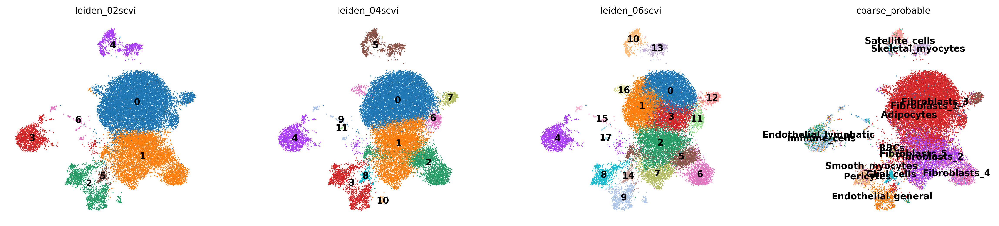

In [24]:
sc.tl.leiden(adata, resolution = 0.2, key_added = 'leiden_02scvi')
sc.tl.leiden(adata, resolution = 0.4, key_added = 'leiden_04scvi')
sc.tl.leiden(adata, resolution = 0.6, key_added = 'leiden_06scvi')
sc.pl.umap(adata, color=["leiden_02scvi", "leiden_04scvi", "leiden_06scvi", "coarse_probable"], 
           legend_loc="on data", frameon=False, ncols=4)

### 5) We will proceed with annotating the clusters at 0.4 resolution. First, calculate and visualise those cluster dendrograms using sc.tl and sc.pl.dendrogram(). How do you interpret the resulting plot?

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden_04scvi']`


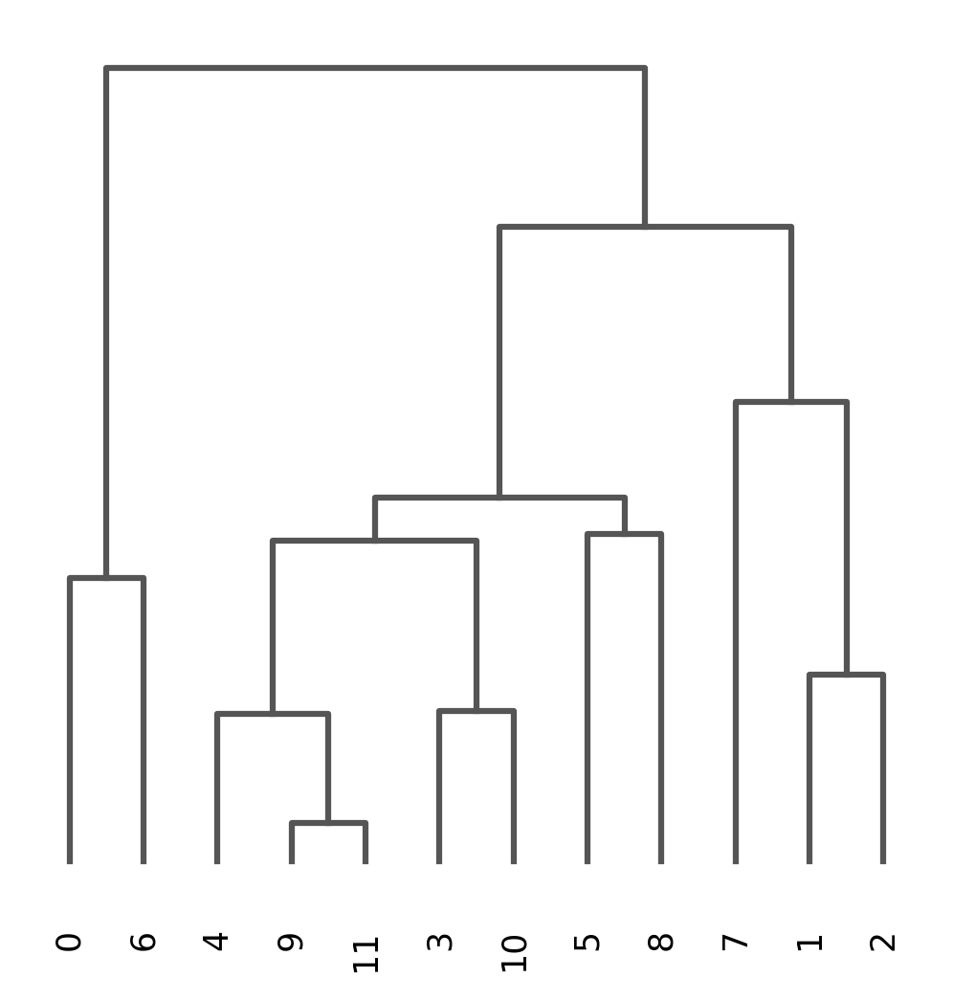

<Axes: >

In [25]:
sc.tl.dendrogram(adata, 'leiden_04scvi')
sc.pl.dendrogram(adata, 'leiden_04scvi')

### 6) Rank the genes within the clusters using the wilcoxon testing method with sc.tl.rank_genes_groups(). Check the parameters with SHIFT+TAB. Which counts should you use? Plot the top 25 genes for each cluster using sc.pl.rank_genes_groups().

ranking genes
    finished: added to `.uns['wilcoxon_04scvi']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:34)


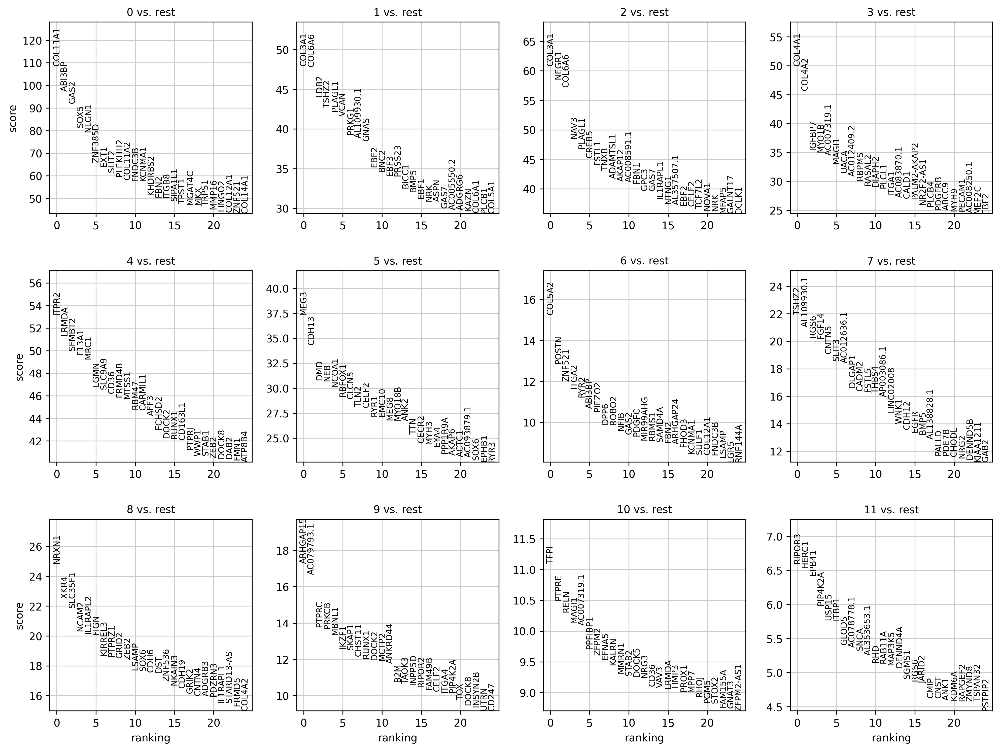

In [26]:
sc.tl.rank_genes_groups(adata, groupby='leiden_04scvi', method='wilcoxon', key_added='wilcoxon_04scvi', 
                        use_raw=True, # use the full normalised counts matrix stored in the adata.raw state
                       )
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, key='wilcoxon_04scvi')

### 7) Visualise the top 5 differentially expressed genes for each cluster with scanpy sc.pl.rank_genes_groups_dotplot(), sc.pl.rank_genes_groups_matrixplot () and sc.pl.rank_genes_groups_heatmap() functions

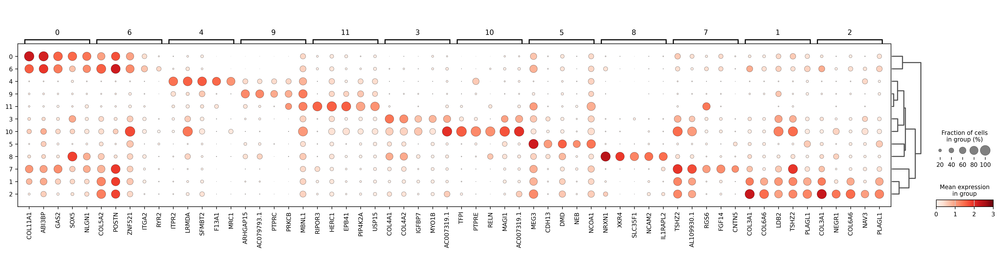

In [27]:
sc.pl.rank_genes_groups_dotplot(adata, n_genes=5, groupby='leiden_04scvi',
                                use_raw=True, 
                                vmax=3, vmin=0, 
                                key='wilcoxon_04scvi',
                                #save='topDEGs04scvi_norm.svg'
                               )

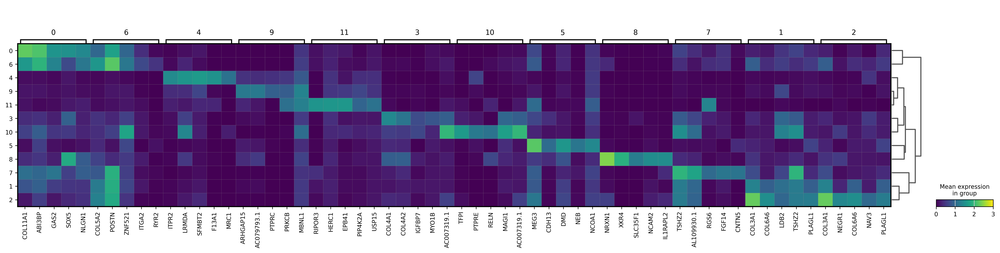

In [28]:
sc.pl.rank_genes_groups_matrixplot(adata, n_genes=5, groupby='leiden_04scvi',
                                use_raw=True, 
                                vmax=3, vmin=0, 
                                key='wilcoxon_04scvi',
                                #save='topDEGs04scvi_norm.svg'
                               )

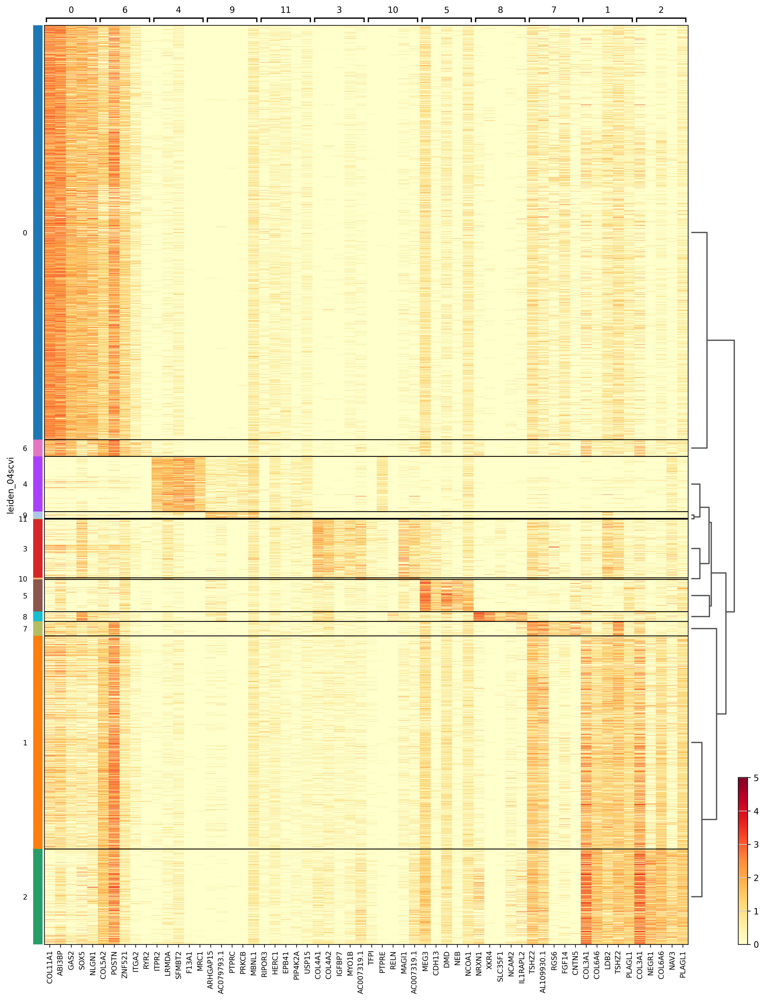

In [29]:
sc.pl.rank_genes_groups_heatmap(adata, n_genes=5, key="wilcoxon_04scvi", groupby="leiden_04scvi",
                                show_gene_labels=True, figsize=(15,20), use_raw=True,
                                cmap='YlOrRd', #save='heatmap.png'
                                )

### Visualise the distribution of markers in the 'filtered_coarse_markers' dictionary using dotplots. What do you think about their specificity/suitability for this data?

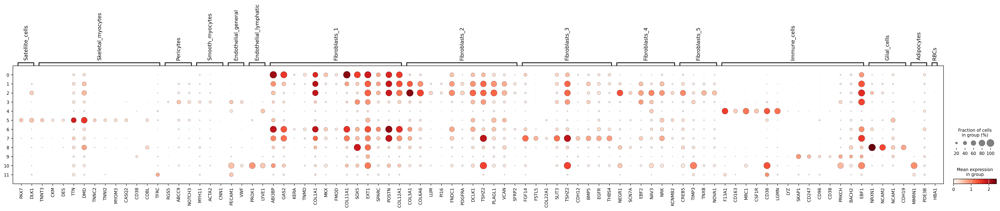

In [30]:
sc.pl.dotplot(adata, filtered_coarse_markers, groupby='leiden_04scvi', swap_axes=False,
              use_raw=True, dendrogram=False, var_group_rotation=90,
              #vcenter=45,
              #save='_full_annotation_scANVI.svg'
             )

### Are you satisfied with the resulting clusterings based on the results of DGE and our previous cluster-free annotations? Would you want to compare clusters or subcluster anything further?

I would personally check that clusters 1 and 4 are sufficiently distinct to be separate, and subcluster clusters 2, 5, and 6, which correspond to endothelial, muscle, and fibroblast/neuronal cells, respectively.

### 8) You can see that clusters 1 and 4 look kind of similar based on their DEGs. Let's investigate them further. Run sc.tl.rank_genes_groups() so that cluster 4 is compared specifically against 1. Plot the ranked genes as before.

ranking genes
    finished: added to `.uns['wilcoxon_04scvi_4vs1']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:08)


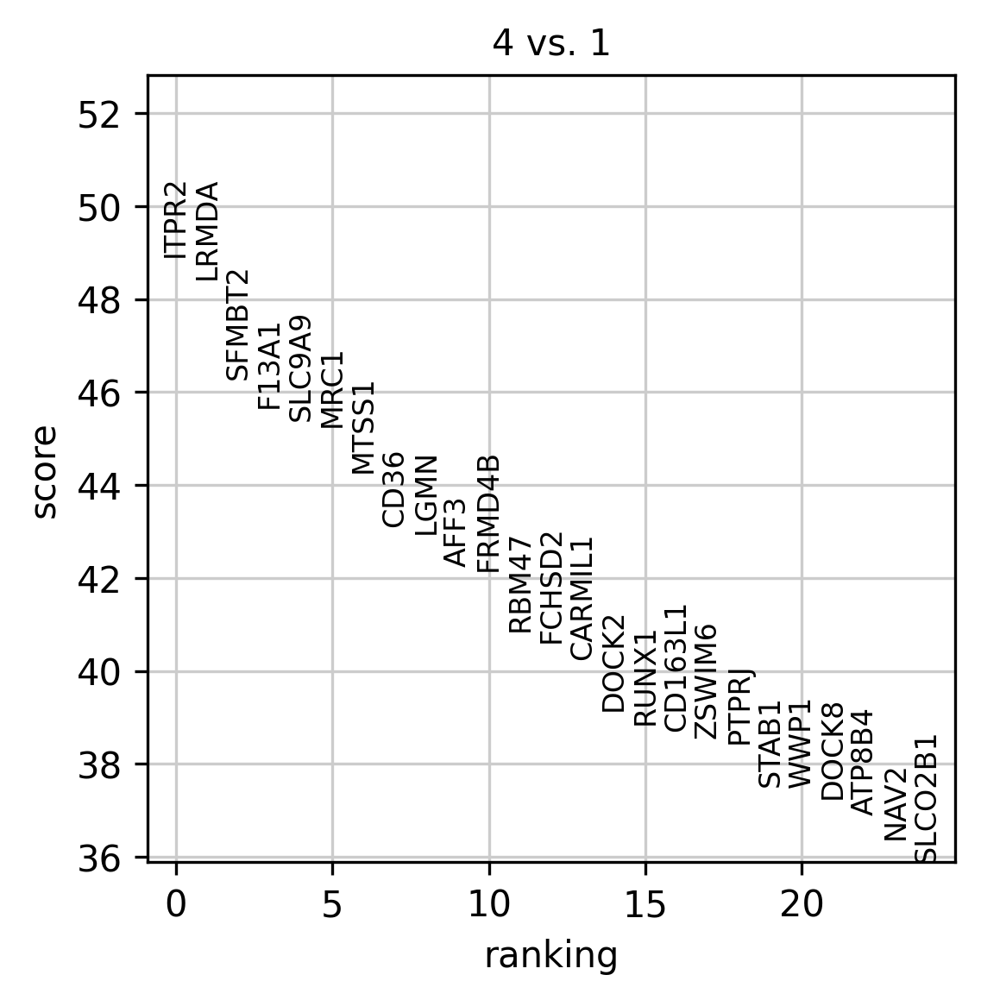

In [31]:
sc.tl.rank_genes_groups(adata, groupby='leiden_04scvi', 
                        groups=['4'], reference='1',
                        method='wilcoxon', key_added='wilcoxon_04scvi_4vs1', 
                        use_raw=True, # use the full normalised counts matrix
                       )
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False, key='wilcoxon_04scvi_4vs1')

### 9) Retrieve the top 50 DEGs from this comparison. This information can be extracted from the output of the sc.tl.rank_genes_groups() function.

<details>
<summary>Click to reveal hint</summary>

_The results are stored as a dictionary within adata.uns['yourrankingkeyname']. You can extract the genes by accessing the adata.uns['yourrankingkeyname'][comparisongroup]['names']. Comparison group names can be accessed by checking adata.uns['yourrankingkeyname']['names'].dtype.names_
</details>

In [32]:
result = adata.uns['wilcoxon_04scvi_4vs1']
result

{'params': {'groupby': 'leiden_04scvi',
  'reference': '1',
  'method': 'wilcoxon',
  'use_raw': True,
  'layer': None,
  'corr_method': 'benjamini-hochberg'},
 'names': rec.array([('ITPR2',), ('LRMDA',), ('SFMBT2',), ..., ('DLC1',),
            ('RBMS3',), ('PRKG1',)],
           dtype=[('4', 'O')]),
 'scores': rec.array([( 48.91029 ,), ( 48.430614,), ( 46.28866 ,), ...,
            (-47.67266 ,), (-48.215164,), (-50.192326,)],
           dtype=[('4', '<f4')]),
 'pvals': rec.array([(0.,), (0.,), (0.,), ..., (0.,), (0.,), (0.,)],
           dtype=[('4', '<f8')]),
 'pvals_adj': rec.array([(0.,), (0.,), (0.,), ..., (0.,), (0.,), (0.,)],
           dtype=[('4', '<f8')]),
 'logfoldchanges': rec.array([( 6.3135886,), ( 4.9790354,), ( 4.3620486,), ...,
            (-5.1220856,), (-5.1463275,), (-5.516232 ,)],
           dtype=[('4', '<f4')])}

In [33]:
top_names = result['names']['4'][:50]
top_names

array(['ITPR2', 'LRMDA', 'SFMBT2', 'F13A1', 'SLC9A9', 'MRC1', 'MTSS1',
       'CD36', 'LGMN', 'AFF3', 'FRMD4B', 'RBM47', 'FCHSD2', 'CARMIL1',
       'DOCK2', 'RUNX1', 'CD163L1', 'ZSWIM6', 'PTPRJ', 'STAB1', 'WWP1',
       'DOCK8', 'ATP8B4', 'NAV2', 'SLCO2B1', 'MEF2C', 'FMN1', 'ADAP2',
       'MAF', 'ZEB2', 'DAB2', 'SELENOP', 'BMP2K', 'HRH1', 'SCN1A-AS1',
       'FAM49B', 'DISC1', 'HDAC9', 'MYO5A', 'SPRED1', 'PTPRE', 'TBXAS1',
       'SYK', 'FLI1', 'ARHGAP18', 'ELMO1', 'COLEC12', 'AOAH', 'FCGRT',
       'NPL'], dtype=object)

### BONUS (optional): if you have time (you probably won't...), think of a way of doing this as a for loop to extract the top10 degs for each group for all results in adata.uns['wilcoxon_04scvi']

In [34]:
result = adata.uns['wilcoxon_04scvi']
groups = result['names'].dtype.names

# create an empty dictionary to store the top names for each cell_type
top_DEGs_dict = {}

for group in groups:
    top_names2 = result['names'][group][:10] # select the top 10 names for this cell_type
    top_DEGs_dict[group] = list(top_names2) # add the list of top names to the dictionary
    
top_DEGs_dict

{'0': ['COL11A1',
  'ABI3BP',
  'GAS2',
  'SOX5',
  'NLGN1',
  'ZNF385D',
  'EXT1',
  'SLIT2',
  'PLEKHH2',
  'COL11A2'],
 '1': ['COL3A1',
  'COL6A6',
  'LDB2',
  'TSHZ2',
  'PLAGL1',
  'VCAN',
  'PRKG1',
  'AL109930.1',
  'GNAS',
  'EBF2'],
 '2': ['COL3A1',
  'NEGR1',
  'COL6A6',
  'NAV3',
  'PLAGL1',
  'CREB5',
  'FSTL1',
  'TNXB',
  'ADAMTSL1',
  'AKAP12'],
 '3': ['COL4A1',
  'COL4A2',
  'IGFBP7',
  'MYO1B',
  'AC007319.1',
  'MAGI1',
  'UACA',
  'AC012409.2',
  'RBPMS',
  'RASAL2'],
 '4': ['ITPR2',
  'LRMDA',
  'SFMBT2',
  'F13A1',
  'MRC1',
  'LGMN',
  'SLC9A9',
  'CD36',
  'FRMD4B',
  'MTSS1'],
 '5': ['MEG3',
  'CDH13',
  'DMD',
  'NEB',
  'NCOA1',
  'RBFOX1',
  'CLCN5',
  'TLN2',
  'CELF2',
  'RYR1'],
 '6': ['COL5A2',
  'POSTN',
  'ZNF521',
  'ITGA2',
  'RYR2',
  'ABI3BP',
  'PIEZO2',
  'DPP6',
  'ROBO2',
  'NFIB'],
 '7': ['TSHZ2',
  'AL109930.1',
  'RGS6',
  'FGF14',
  'CNTN5',
  'SLIT3',
  'AC012636.1',
  'DLGAP1',
  'CADM2',
  'FSTL5'],
 '8': ['NRXN1',
  'XKR4',
  'SLC35F1',


### 10) Plot the top 10 DEGs in top_names using UMAPs. Does it look like they are specific to a cell group corresponding to cluster 4?

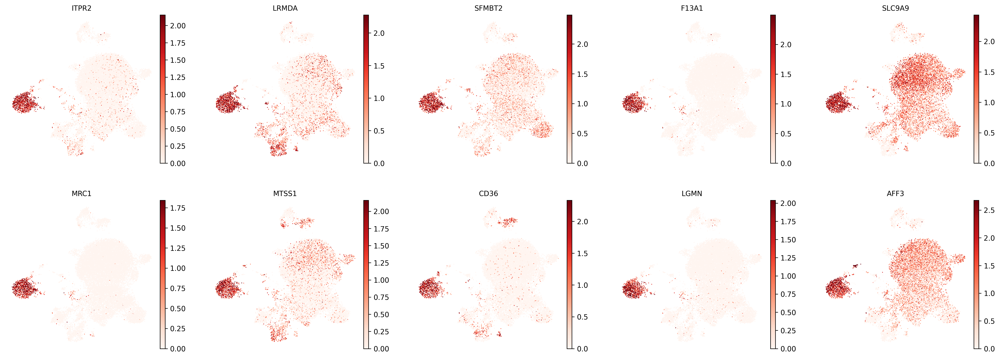

In [35]:
sc.pl.umap(
    adata,
    color= top_names[:10],
    legend_loc='on data', legend_fontsize=12, ncols=5,
    vmin=0,
    vmax="p99",  # set vmax to the 99th percentile of the gene count instead of the maximum, to prevent outliers from making expression in other cells invisible. Note that this can cause problems for extremely lowly expressed genes.
    sort_order=False,  # do not plot highest expression on top, to not get a biased view of the mean expression among cells
    frameon=False,
    cmap="Reds",  # or choose another color map e.g. from here: https://matplotlib.org/stable/tutorials/colors/colormaps.html
    #save=f'cluster{cluster}_topDEGs_leiden04scvi.svg'
)
print()

### Based on this, would you combine clusters 1 and 4 into a single cell type?

I wouldn't :) But tbf it's hard to know for sure, you need to dig deep and check the markers.

### 11) Subcluster cluster 6 further using the given functions. Explain what is being done, annotate the code to understand what and why - ask if not sure :)

In [36]:
subadata = adata[adata.obs['leiden_04scvi'] == '6', :].copy()
sc.tl.leiden(subadata, resolution=0.2, key_added='6_sub') 
subadata.obs['6_sub'] = [
    f"6.{new_cluster}" for new_cluster in subadata.obs['6_sub']
]

running Leiden clustering
    finished: found 2 clusters and added
    '6_sub', the cluster labels (adata.obs, categorical) (0:00:00)


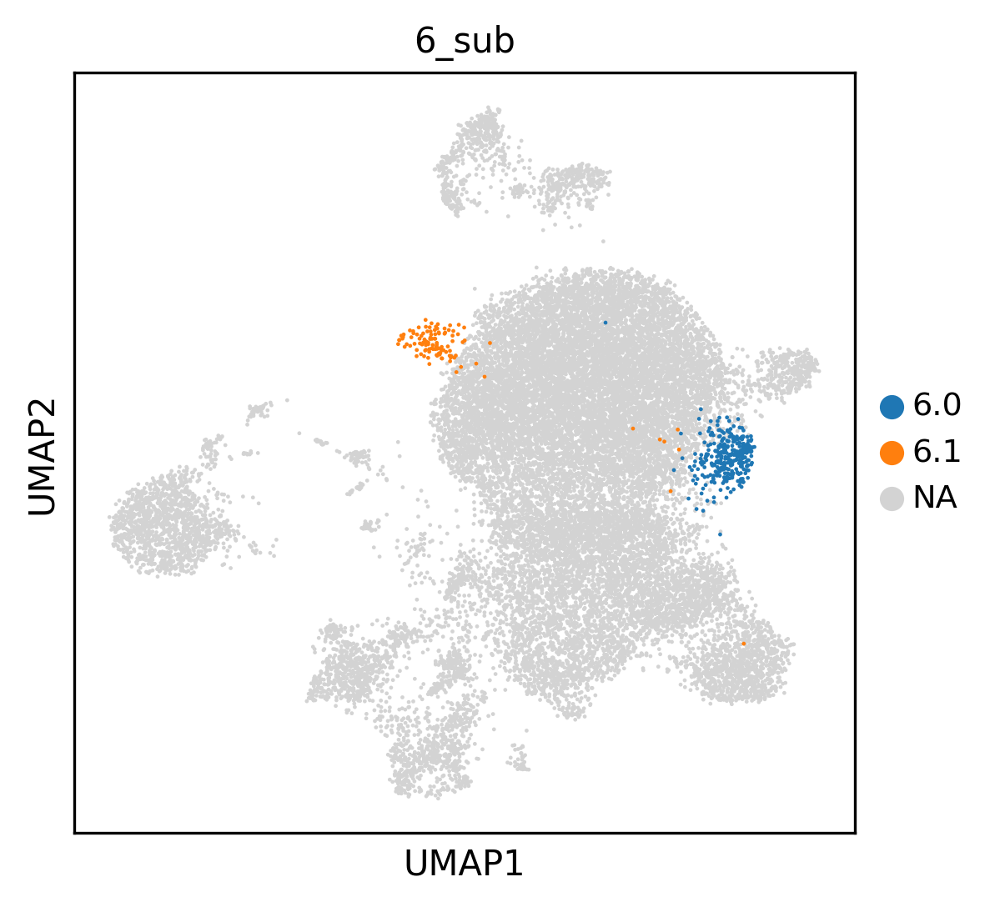

In [37]:
adata.obs.loc[subadata.obs.index, '6_sub'] = subadata.obs['6_sub']
sc.pl.umap(adata, color='6_sub')

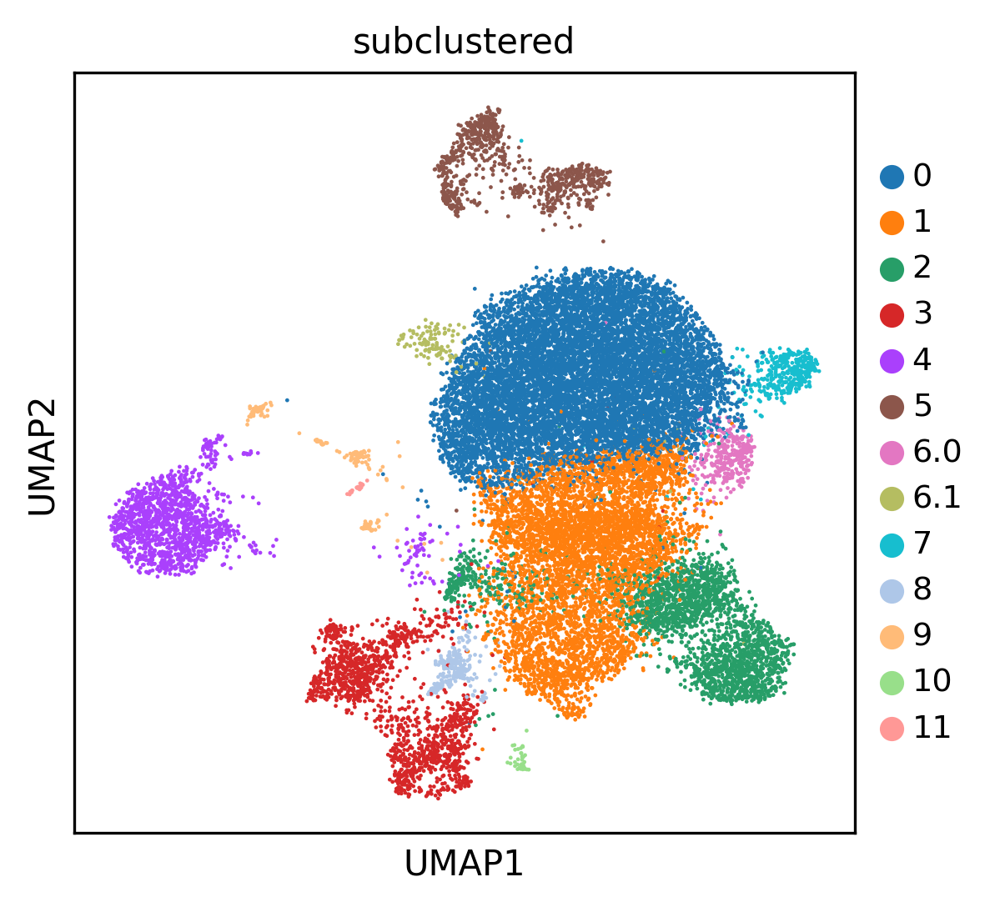

In [38]:
#need to convert names to string, otherwise it will throw an error saying you can't add new categories like that:
adata.obs['subclustered'] = adata.obs['leiden_04scvi'].astype(str).copy() 

adata.obs.loc[subadata.obs.index, 'subclustered'] = subadata.obs['6_sub']
sc.pl.umap(adata, color='subclustered')

### 12) Run the following code to save the results of the full (all clusters) between-cluster DGE analysis into a dataframe and export it as a .csv file. NB! You would need to re-run the wilcoxon analysis to save with the newly subclustered clusters, but this is for demonstation purposes, so don't worry about it.

In [39]:
result = adata.uns['wilcoxon_04scvi']
groups = result['names'].dtype.names

df = pd.DataFrame(
    {group + '_' + key: result[key][group]
    for group in groups 
    for key in ['names','scores','logfoldchanges', 'pvals', 'pvals_adj']}
)
df.to_csv(os.path.join(RESULTS_FOLDERNAME, 'wilcoxon_DGE_04scvi.csv'))
df.head(5)

,0_names,0_scores,0_logfoldchanges,0_pvals,0_pvals_adj,1_names,1_scores,1_logfoldchanges,1_pvals,1_pvals_adj,...,10_names,10_scores,10_logfoldchanges,10_pvals,10_pvals_adj,11_names,11_scores,11_logfoldchanges,11_pvals,11_pvals_adj
0,COL11A1,108.541435,3.666043,0.0,0.0,COL3A1,47.912315,1.948786,0.0,0.0,...,TFPI,11.095634,6.680924,1.317214e-28,2.805402e-24,RIPOR3,6.599026,4.964267,4.138685e-11,5.148575e-07
1,ABI3BP,97.403046,2.955015,0.0,0.0,COL6A6,47.840305,1.846468,0.0,0.0,...,PTPRE,10.498435,5.338382,8.782438e-26,9.352418e-22,HERC1,6.536283,3.613630,6.306648e-11,5.148575e-07
2,GAS2,91.972229,2.972009,0.0,0.0,LDB2,44.056980,1.485471,0.0,0.0,...,RELN,10.306806,7.505142,6.564707e-25,4.660505e-21,EPB41,6.421815,4.709508,1.346588e-10,7.169906e-07
3,SOX5,81.425217,2.562540,0.0,0.0,TSHZ2,42.645473,1.414303,0.0,0.0,...,MAGI1,10.132733,4.456856,3.954379e-24,2.105509e-20,PIP4K2A,5.987760,3.979198,2.127513e-09,7.644440e-06
4,NLGN1,79.400749,2.640186,0.0,0.0,PLAGL1,42.187016,1.393028,0.0,0.0,...,AC007319.1,10.094334,4.764978,5.852697e-24,2.493015e-20,USP15,5.768793,3.389358,7.984141e-09,1.805407e-05


In [40]:
#built-in alternative that gives a narrow dataframe instead of the wide one above:
#df = sc.get.rank_genes_groups_df(adata, group=None, key='wilcoxon_04scvi_sub231')
#df

### You could now, for example, use the following outside resources to annotate clusters:
- https://cellxgene.cziscience.com - Gene Expression tab
- https://biit.cs.ut.ee/gprofiler/gost - to Run GO pathway analysis e.g. using 100-300 DEGs

  etc. check lecture slides


### 13) Let's say we've done the work, looked through the DEGs and have a rough idea of what we want as our cell type annotations from clusters. To do this, create a new adata.obs column called 'cell_type' by copying the leiden clusters. Then, create a dictionary of cell_type_names where leiden clusters (str) are keys and your selected cell type names (str) are values. Label any unknown clusters and/or clusters separating by cell division markers as "Unknown".

In [41]:
[key for key in filtered_coarse_markers.keys()]

['Satellite_cells',
 'Skeletal_myocytes',
 'Pericytes',
 'Smooth_myocytes',
 'Endothelial_general',
 'Endothelial_lymphatic',
 'Fibroblasts_1',
 'Fibroblasts_2',
 'Fibroblasts_3',
 'Fibroblasts_4',
 'Fibroblasts_5',
 'Immune_cells',
 'Glial_cells',
 'Adipocytes',
 'RBCs']

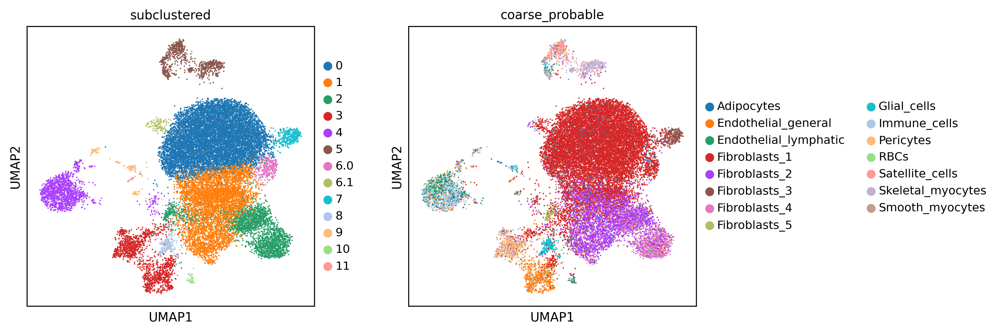

In [42]:
sc.pl.umap(adata, color=['subclustered', 'coarse_probable'])

In [43]:
adata.obs['cell_type'] = adata.obs['subclustered'].copy()

cell_type_names = { 
    '0': 'Fibroblasts 1', 
    '1': 'Fibroblasts 2', 
    '2': 'Vascular Endothelial Cells', 
    '3': 'Macrophages', 
    '4': 'Fibroblasts_4', 
    '5': 'Myocytes',
    '6.0': 'Glial Cells',
    '6.1': 'Fibroblasts_5',
    '6.2': 'Unknown', #some odd small cluster
    '7': 'Fibroblasts_3',
    '8': 'Immune Cells',
    '9': 'Lymphatic Endothelial Cells',
    '10': 'Unknown' #some odd small cluster
}
adata.obs['cell_type'] = adata.obs['cell_type'].replace(cell_type_names)

/tmp/ipykernel_791466/383063096.py:18: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  adata.obs['cell_type'] = adata.obs['cell_type'].replace(cell_type_names)


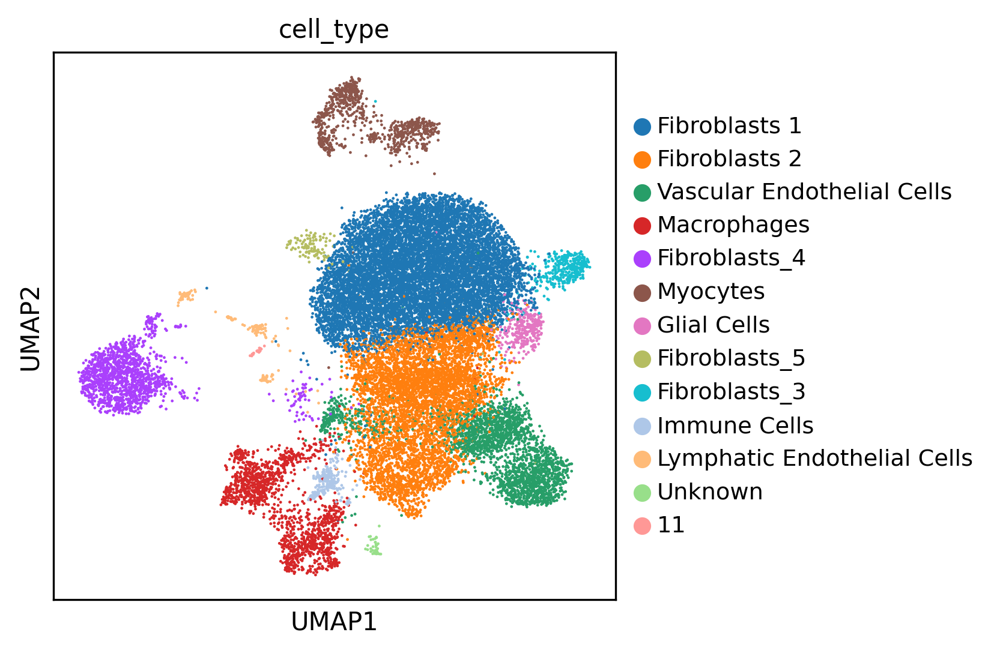

In [44]:
sc.pl.umap(adata, color='cell_type')

In [45]:
adata.write(os.path.join(RESULTS_FOLDERNAME, 'annotated_scVI.h5ad'))

# BONUS PART3: Transfer Learning with scANVI (sort of...)

Normally, scANVI is used to transfer labels after scVI in cases when at least one of the datasets contains labelled cell types (e.g when integrating an experiment with labelled cell types with experiments where cell types are not labelled). 

In our case, we trained the scVI model on datasets that were initially labelled. Nevertheless, we can still use scANVI to refine out cluster annotations by utilising its probabilistic labelling capabilities.

scANVI is able to reassign cell types when cells are labelled as "Unknown". Let's put this to the test!

In [46]:
adata = sc.read_h5ad(os.path.join(RESULTS_FOLDERNAME, 'annotated_scVI.h5ad'))
adata

AnnData object with n_obs × n_vars = 23281 × 2374
    obs: 'samplename', 'sex', 'age', 'donor', 'type', 'libbatch', 'barcode', 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'mt_outlier', 'doublet_score', 'predicted_doublet', 'size_factors', 'S_score', 'G2M_score', 'phase', '_scvi_batch', '_scvi_labels', 'conflict', 'coarse_definitive', 'coarse_probable', 'leiden_02scvi', 'leiden_04scvi', 'leiden_06scvi', '6_sub', 'subclustered', 'cell_type'
    var: 'n_counts', 'means', 'variances', 'residual_variances', 'highly_variable_rank', 'highly_variable_nbatches', 'highly_variable_intersection', 'highly_variable', 'mean', 'std'
    uns: '6_sub_colors', '_scvi_manager_uuid', '_scvi_uuid', 

### 14) Load your trained scVI model from yesterday

In [57]:
scvi.settings.num_threads = 10

In [50]:
vae = scvi.model.SCVI.load(os.path.join(data_dir, "HVG_LibbatchDonorSexTypeCC_nb_n_hidden256_n_latent14_n_layers3_121ep/"), 
               adata=adata)
vae

INFO     File                                                                                                      
         /project/shared/python/3_python_single_cell/results/HVG_LibbatchDonorSexTypeCC_nb_n_hidden256_n_latent14_n
         _layers3_121ep/model.pt already downloaded                                                                


/package/python-cbrg/current/3.11/lib/python3.11/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /package/python-cbrg/current/3.11/lib/python3.11/sit ...


SCVI model with the following parameters: 
n_hidden: 256, n_latent: 14, n_layers: 3, dropout_rate: 0.1, dispersion: gene-batch, gene_likelihood: nb, 
latent_distribution: normal.
Training status: Trained
Model's adata is minified?: False

In [51]:
vae.view_anndata_setup(adata)

Anndata setup with scvi-tools version 1.2.2.post2.

Setup via `SCVI.setup_anndata` with arguments:

{
│   'layer': 'counts',
│   'batch_key': 'libbatch',
│   'labels_key': None,
│   'size_factor_key': None,
│   'categorical_covariate_keys': ['type', 'donor', 'sex'],
│   'continuous_covariate_keys': ['S_score', 'G2M_score']
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│         n_batch          │   2   │
│         n_cells          │ 23281 │
│ n_extra_categorical_covs │   3   │
│ n_extra_continuous_covs  │   2   │
│         n_labels         │   1   │
│          n_vars          │ 2374  │
└──────────────────────────┴───────┘

                             Data Registry                             
┏━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Registry Key      ┃            scvi-tools Location             ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│           X            │           adata.layers['counts']           │
│         batch          │          adata.obs['_scvi_batch']          │
│ extra_categorical_covs │ adata.obsm['_scvi_extra_categorical_covs'] │
│ extra_continuous_covs  │ adata.obsm['_scvi_extra_continuous_covs']  │
│         labels         │         adata.obs['_scvi_labels']          │
└────────────────────────┴────────────────────────────────────────────┘

                    batch State Registry                    
┏━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃    Source Location    ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['libbatch'] │  Jan2023   │          0          │
│                       │  Sep2022   │          1          │
└───────────────────────┴────────────┴─────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

          extra_categorical_covs State Registry          
┏━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃  Source Location   ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['donor'] │  DEV15984  │          0          │
│                    │  DEV16127  │          1          │
│                    │  DEV16569  │          2          │
│                    │            │                     │
│  adata.obs['sex']  │   female   │          0          │
│                    │    male    │          1          │
│                    │            │                     │
│ adata.obs['type']  │    Ach     │          0          │
│                    │    Quad    │          1          │
│                    │            │                     │
└────────────────────┴────────────┴─────────────────────┘

  extra_continuous_covs   
      State Registry      
┏━━━━━━━━━━━━━━━━━━━━━━━━┓
┃    Source Location     ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━┩
│  adata.obs['S_score']  │
│ adata.obs['G2M_score'] │
└────────────────────────┘

In [54]:
# If you need to relabel anything you can use the following: 
# adata.obs['cell_type'] = adata.obs['cell_type'].replace(['Dividing Cells', 'Unknown Cells'], 'Unknown')

### 15) Initialise and train the scANVI model from scVI

In [55]:
lvae = scvi.model.SCANVI.from_scvi_model(
    vae,
    adata=adata,
    labels_key="cell_type",
    unlabeled_category="Unknown"
)

In [56]:
lvae.train(max_epochs=10, train_size = 0.9, validation_size = 0.1, 
          accelerator='cpu', batch_size=300,
          check_val_every_n_epoch=1)

INFO     Training for 10 epochs.                                                                                   


/package/python-cbrg/current/3.11/lib/python3.11/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /package/python-cbrg/current/3.11/lib/python3.11/sit ...
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/package/python-cbrg/current/3.11/lib/python3.11/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /package/python-cbrg/current/3.11/lib/python3.11/sit ...
/package/python-cbrg/current/3.11/lib/python3.11/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:425: The 'train_dataloader' does not have many workers which may be a

Training:   0%|          | 0/10 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=10` reached.


### 16) Get the C_scANVI cell label predictions as well as the X_scANVI latent representation embeddings. Calculate new neighbors using those and generate UMAPs.

In [58]:
adata.obs["C_scANVI"] = lvae.predict(adata)
adata.obsm["X_scANVI"] = lvae.get_latent_representation(adata)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:05)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:15)


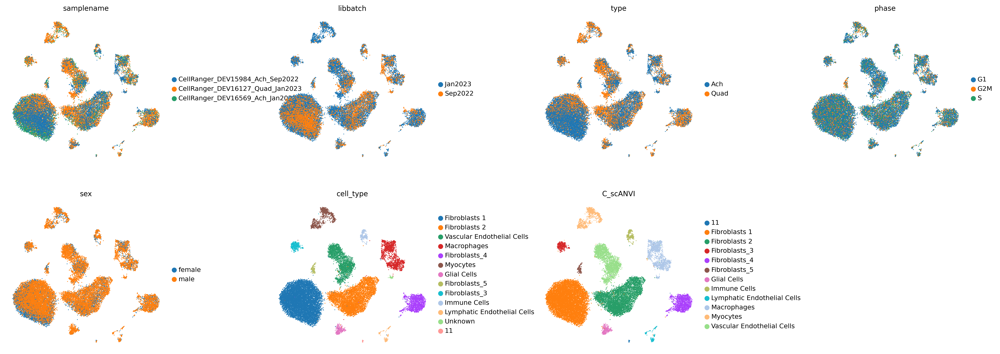

In [59]:
sc.pp.neighbors(adata, use_rep="X_scANVI", metric='correlation')
sc.tl.umap(adata)
sc.pl.umap(adata, color=['samplename', 'libbatch', 'type', 'phase', 'sex', 'cell_type', 'C_scANVI'],
           frameon=False, wspace=0.5
          )

### 17) Compare the predicted cell labels vs our cell type annotations. How have the Unknown cells (dividing) been distributed?

In [60]:
df = adata.obs.groupby(["cell_type", "C_scANVI"]).size().unstack(fill_value=0)
conf_mat = df / df.sum(axis=1).values[:, np.newaxis]

/tmp/ipykernel_791466/111448312.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df = adata.obs.groupby(["cell_type", "C_scANVI"]).size().unstack(fill_value=0)


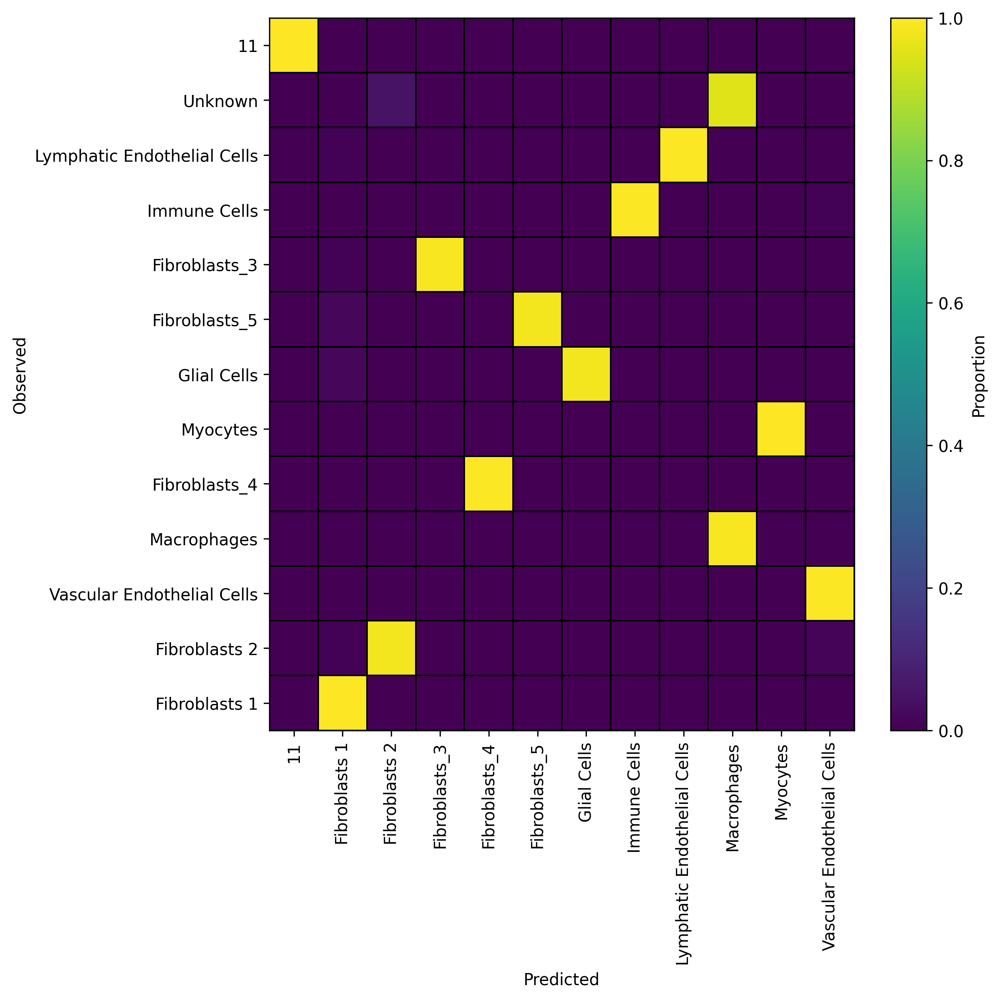

In [61]:
plt.figure(figsize=(8, 8))
plt.pcolormesh(conf_mat, edgecolors='k', linewidths=0.5, cmap='viridis')
plt.xticks(np.arange(0.5, len(df.columns), 1), df.columns, rotation=90)
plt.yticks(np.arange(0.5, len(df.index), 1), df.index)
plt.grid(False)
plt.xlabel("Predicted")
plt.ylabel("Observed")

# Add colorbar for better interpretation of the plot
plt.colorbar(label='Proportion')
# Save the plot:
# savesvg('scANVI_prediction_matrix.svg', plt)

plt.show()

In [63]:
adata.write(os.path.join(RESULTS_FOLDERNAME, 'annotated_scVI.h5ad'))